# Task 1

---

## Web scraping and analysis

This Jupyter notebook includes some code to get you started with web scraping. We will use a package called `BeautifulSoup` to collect the data from the web. Once you've collected your data and saved it into a local `.csv` file you should start with your analysis.

### Scraping data from Skytrax

If you visit [https://www.airlinequality.com] you can see that there is a lot of data there. For this task, we are only interested in reviews related to British Airways and the Airline itself.

If you navigate to this link: [https://www.airlinequality.com/airline-reviews/british-airways] you will see this data. Now, we can use `Python` and `BeautifulSoup` to collect all the links to the reviews and then to collect the text data on each of the individual review links.

In [1]:
import requests
from bs4 import BeautifulSoup
import pandas as pd

In [2]:
base_url = "https://www.airlinequality.com/airline-reviews/british-airways"
pages = 6
page_size = 100

reviews = []

# for i in range(1, pages + 1):
for i in range(1, pages + 1):

    print(f"Scraping page {i}")

    # Create URL to collect links from paginated data
    url = f"{base_url}/page/{i}/?sortby=post_date%3ADesc&pagesize={page_size}"

    # Collect HTML data from this page
    response = requests.get(url)

    # Parse content
    content = response.content
    parsed_content = BeautifulSoup(content, 'html.parser')
    for para in parsed_content.find_all("div", {"class": "text_content"}):
        reviews.append(para.get_text())
    
    print(f"   ---> {len(reviews)} total reviews")

Scraping page 1
   ---> 100 total reviews
Scraping page 2
   ---> 200 total reviews
Scraping page 3
   ---> 300 total reviews
Scraping page 4
   ---> 400 total reviews
Scraping page 5
   ---> 500 total reviews
Scraping page 6
   ---> 600 total reviews


In [3]:
df = pd.DataFrame()
df["reviews"] = reviews
df.head()

,reviews
0,✅ Trip Verified | Stupidly tried BA again aft...
1,Not Verified | Seat horribly narrow; 3-4-3 on...
2,✅ Trip Verified | Glasgow to London delayed b...
3,✅ Trip Verified | When I tried to check in on...
4,✅ Trip Verified | I flew from Prague to LHR. ...


In [4]:
df.to_csv("data/BA_reviews.csv")

In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import nltk
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.corpus import stopwords
from wordcloud import WordCloud,STOPWORDS
from bs4 import BeautifulSoup
from textblob import TextBlob
from textblob import Word



import textblob
import plotly.express as px
from nltk.sentiment.vader import SentimentIntensityAnalyzer as vad


In [6]:
df=df['reviews'].apply(lambda x : x.replace('✅ Trip Verified |','').replace('Not Verified |',''))
data=pd.DataFrame(df)

In [7]:
data.head()

,reviews
0,Stupidly tried BA again after a five year ga...
1,Seat horribly narrow; 3-4-3 on a 777. Thankf...
2,Glasgow to London delayed by 1 hour. My wife...
3,"When I tried to check in online, I was offer..."
4,I flew from Prague to LHR. Excellent service...


In [8]:
#tf_data=TfidfVectorizer()
# Copying the data into a new dataframe called vader
vader=data.copy()

sentiment=vad()
# Making additional columns for sentiment score in the vader dataframe
sen=['Positive','Negative','Neutral']
sentiments=[sentiment.polarity_scores(i) for i in vader.reviews]
vader['Negative Score']=[i['neg'] for i in sentiments]
vader['Positive Score']=[i['pos'] for i in sentiments]
vader['Neutral Score']=[i['neu'] for i in sentiments]
vader['Compound Score']=[i['compound'] for i in sentiments]
score=vader['Compound Score'].values
t=[]
for i in score:
    if i >=0.05 :
        t.append('Positive')
    elif i<=-0.05 :
        t.append('Negative')
    else:
        t.append('Neutral')
vader['Overall Sentiment']=t

In [9]:
vader.head()

,reviews,Negative Score,Positive Score,Neutral Score,Compound Score,Overall Sentiment
0,Stupidly tried BA again after a five year ga...,0.198,0.064,0.738,-0.9281,Negative
1,Seat horribly narrow; 3-4-3 on a 777. Thankf...,0.051,0.227,0.722,0.8932,Positive
2,Glasgow to London delayed by 1 hour. My wife...,0.181,0.085,0.734,-0.5984,Negative
3,"When I tried to check in online, I was offer...",0.021,0.151,0.828,0.9867,Positive
4,I flew from Prague to LHR. Excellent service...,0.078,0.073,0.849,0.2669,Positive


In [10]:
fig=px.histogram(data_frame=vader,x='Compound Score',color='Overall Sentiment',template='plotly')
fig.show()

C:\Users\adtvr\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<AxesSubplot:xlabel='Overall Sentiment', ylabel='count'>

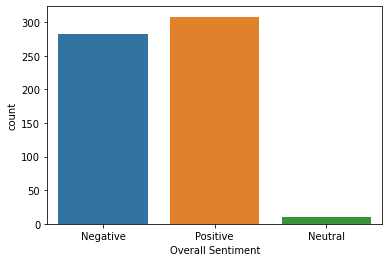

In [11]:
sns.countplot(vader['Overall Sentiment'])

positive =' '.join([i for i in vader['reviews'][vader['Positive Score'] > vader["Negative Score"]]])
stopwords = set(STOPWORDS)
wordcloud = WordCloud(width=192, height=128,stopwords=stopwords, background_color="white").generate(positive)
plt.figure(figsize=(192,128))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [13]:
negative =' '.join([i for i in vader['reviews'][vader['Negative Score'] > vader["Positive Score"]]])
stopwords = set(STOPWORDS)
wordcloud = WordCloud(width=192, height=128,stopwords=stopwords, background_color="white").generate(negative)
plt.figure( figsize=(192,128))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [14]:
x = sum(vader["Positive Score"])
y = sum(vader["Negative Score"])
z = sum(vader["Neutral Score"])

def sentiment_score(a, b, c):
    if (a>b) and (a>c):
        print("Positive 😊 ")
    elif (b>a) and (b>c):
        print("Negative 😠 ")
    else:
        print("Neutral 🙂 ")
sentiment_score(x, y, z)

Neutral 🙂 


In [15]:
print("Positive: ", x)
print("Negative: ", y)
print("Neutral: ", z)

Positive:  66.054
Negative:  50.54000000000001
Neutral:  483.4239999999998
